In [16]:
import pandas as pd
import xml.etree.ElementTree as ET
import glob
import os

path = "C:\\Users\\DELL\\Desktop\\est\\est" 
os.chdir(path)
elements = ['Image', 'height', 'width', 'depth', 'coin_1', 'coin_2', 'coin_3', 'coin_4']
df = pd.DataFrame(columns=elements)

# Initialize empty lists to store coin information
coin_values = {}

# Iterate over XML files in the directory
for xml_file in glob.glob('*.xml'):
    if xml_file.endswith('.xml'):
        # Parse the XML file
        tree = ET.parse(os.path.join(path, xml_file))
        root = tree.getroot()

        # Extract the annotation file name
        file_name = root.find('filename').text

        # Extract size information
        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)
        depth = int(root.find('size/depth').text)

        # Iterate over the 'object' elements
        for obj in root.iter('object'):
            # Extract the coin name
            coin_name = obj.find('name').text

            # Extract the coin value (xmin, ymin, xmax, ymax)
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Store the coin value in the dictionary
            coin_values[coin_name] = (xmin, xmax, ymin, ymax)

        tmp_df = pd.DataFrame([coin_values], columns=['Image', 'height', 'width', 'depth'] + list(coin_values.keys()))
        # Set the 'filename', 'height', 'width', and 'depth' column values
        tmp_df['Image'] = file_name
        tmp_df['height'] = height
        tmp_df['width'] = width
        tmp_df['depth'] = depth

        # Append the data to the DataFrame
        df = pd.concat([df, tmp_df], ignore_index=True)

# Print the DataFrame
df.head()


,Image,height,width,depth,coin_1,coin_2,coin_3,coin_4
0,0.jpg,448,448,3,"(77, 77, 73, 73)","(17, 17, 245, 245)","(373, 373, 112, 112)","(428, 428, 236, 236)"
1,1.jpg,448,448,3,"(89, 89, 167, 167)","(93, 93, 93, 93)","(346, 346, 171, 171)","(336, 336, 89, 89)"
2,10.jpg,448,448,3,"(78, 78, 341, 341)","(20, 20, 186, 186)","(392, 392, 286, 286)","(440, 440, 170, 170)"
3,11.jpg,448,448,3,"(69, 69, 340, 340)","(31, 31, 213, 213)","(390, 390, 270, 270)","(434, 434, 162, 162)"
4,12.jpg,448,448,3,"(72, 72, 338, 338)","(32, 32, 209, 209)","(393, 393, 267, 267)","(441, 441, 153, 153)"


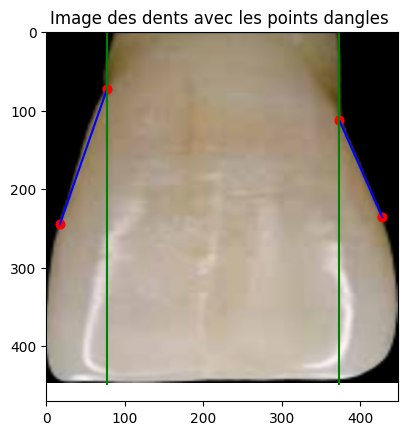

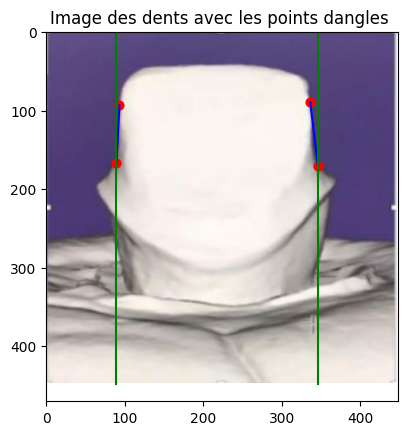

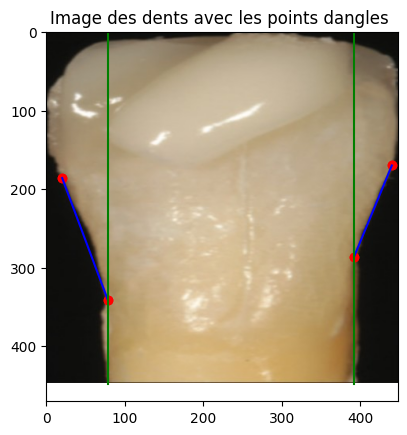

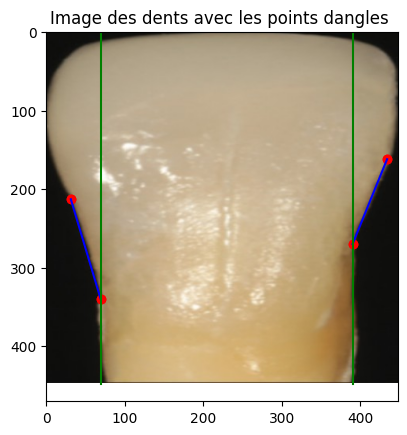

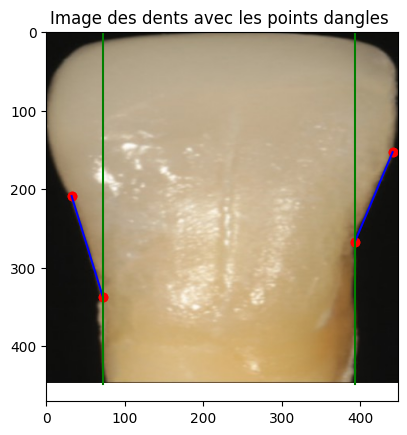

...

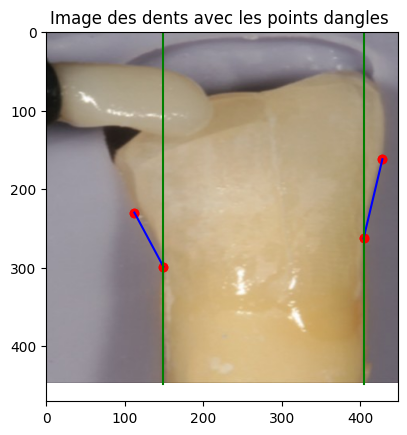

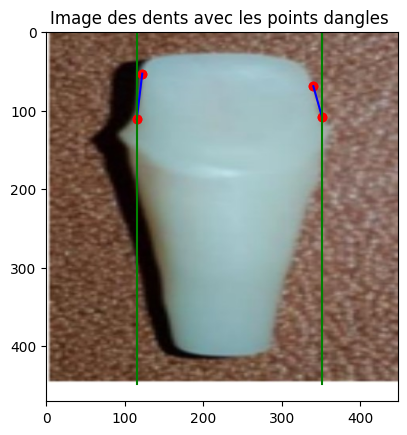

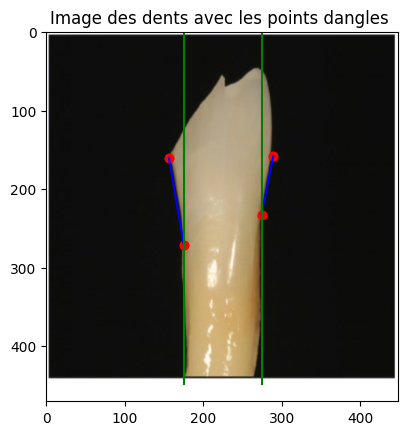

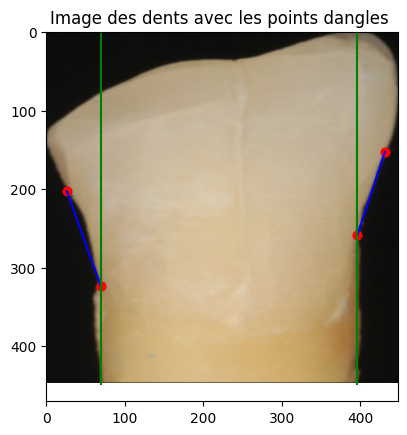

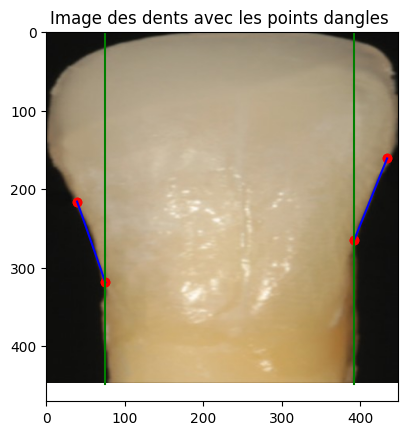

In [17]:
import matplotlib.pyplot as plt 
import cv2

images = df.Image

# Visualize images and their corresponding angle points 
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    
    for p in angle:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')  # Plot the x and y coordinates separately
    
    # Draw lines between the angle points
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j + 1][0]]
        y_coords = [angle[j][2], angle[j + 1][2]]
        x_c00rds = [angle[j][0], angle[j][0]]
        y_c00rds = [448, 0]
        plt.plot(x_coords, y_coords, color='blue')
        plt.plot(x_c00rds, y_c00rds, color='green')

    plt.title('Image des dents avec les points dangles ')
    plt.show()


In [6]:
import cv2
import numpy as np 
import os

images = df.Image
output_folder = "C:\\Users\\DELL\\Desktop\\est\\est" 

# Set the output folder to save the resulting images 
os.makedirs(output_folder, exist_ok=True)

# Visualize images and their corresponding angle points 
for i in range(len(images)):
    image = cv2.imread(images[i])
    mask = np.zeros_like(image)
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points and lines
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j+1][0]] # x-coordinates
        y_coords = [angle[j][2], angle[j+1][2]] # y-coordinates
        cv2.line(mask, (x_coords[0], y_coords[0]), (x_coords[1], y_coords[1]), (255, 255, 255), 2)

    # Prepare mask for augmentation
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY) # Convert mask to grayscale
    mask = np.expand_dims(mask, axis=-1)

    # Save the resulting image
    # Add channel dimension
    output_path = os.path.join(output_folder, f'mask_{images[i][:-4]}.jpg')
    cv2.imwrite(output_path, mask)


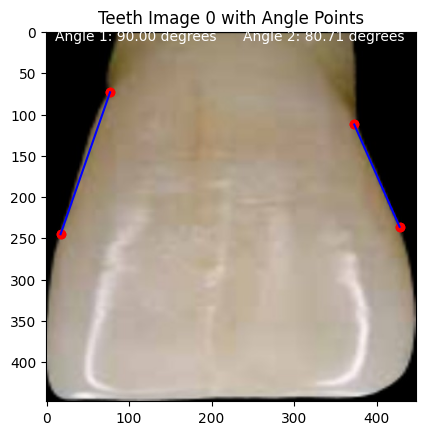

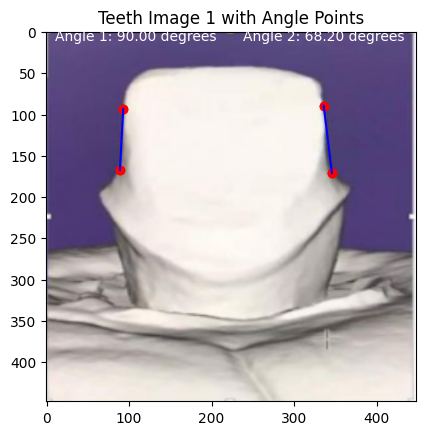

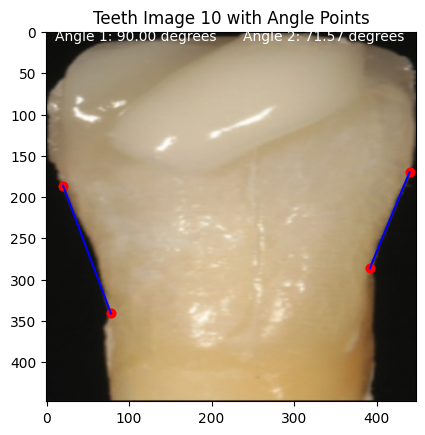

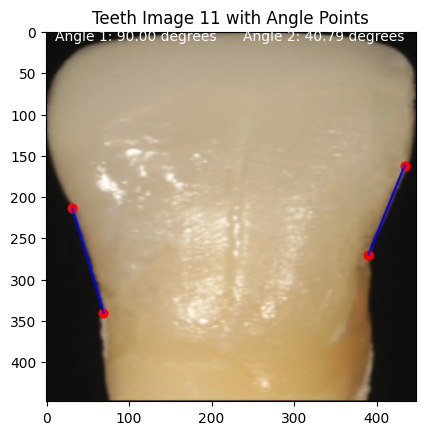

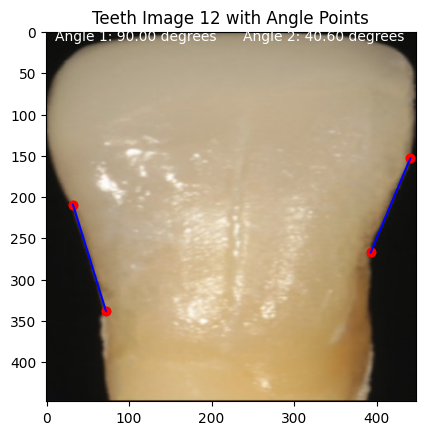

...

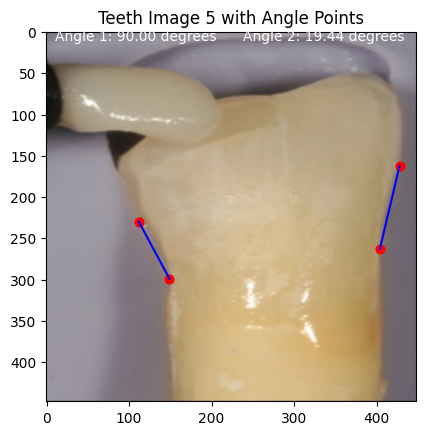

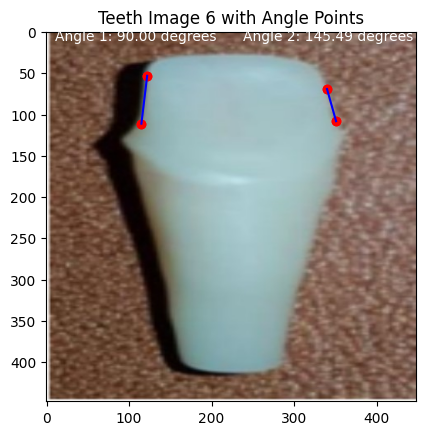

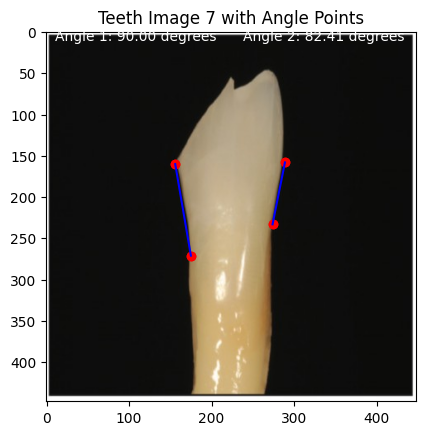

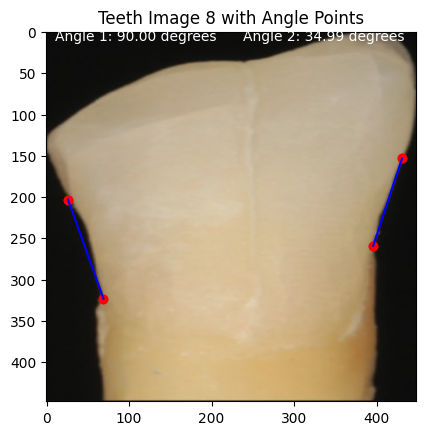

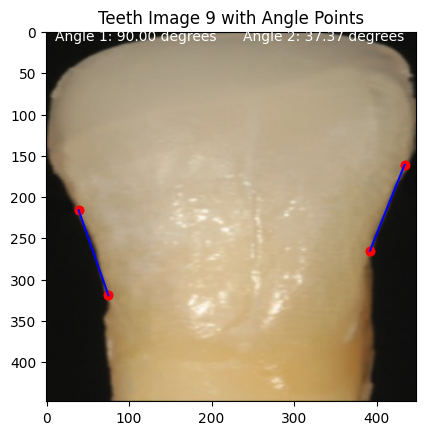

In [7]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

images = df.Image

# Visualize images and their corresponding angle points
for i in range(len(images)):
    image = cv2.imread(images[i])
    angle = [df.loc[i, f'coin_{x}'] for x in range(1, 5)]

    # Plot image with angle points
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Plot scatter points
    for p in angle:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')

    angs = []

    # Draw lines between the angle points
    for j in [0, 2]:
        x_coords = [angle[j][0], angle[j + 1][0]]  # x-coordinates
        y_coords = [angle[j][2], angle[j + 1][2]]  # y-coordinates
        plt.plot(x_coords, y_coords, color='blue')

        # Calculate angle between two lines
        # Define the starting points of the two lines
        line1_start = np.array([angle[j][0], angle[1][2]])
        line2_start = np.array([angle[j + 1][0], 448])

        # Define the ending points of the two lines
        line1_end = np.array([angle[j + 1][0], angle[j + 1][2]])
        line2_end = np.array([angle[j + 1][0], 0])

        # Calculate the direction vectors of the two lines
        line1_vector = line1_end - line1_start
        line2_vector = line2_end - line2_start

        dot_product = np.dot(line1_vector, line2_vector)
        magnitude_product = np.linalg.norm(line1_vector) * np.linalg.norm(line2_vector)
        angle_rad = np.arccos(dot_product / magnitude_product)
        angle_deg = np.degrees(angle_rad)
        angs.append(angle_deg)

    plt.title(f'Teeth Image {images[i][:-4]} with Angle Points')
    plt.text(10, 10, f'Angle 1: {angs[0]:.2f} degrees', color='white') if angs[0] < 180 else plt.text(10, 10, f'Angle: {angs[0] - 360:.2f} degrees', color="red")
    plt.text(238, 10, f'Angle 2: {angs[1]:.2f} degrees', color='white') if angs[1] < 180 else plt.text(10, 10, f'Angle: {angs[1] - 360:.2f} degrees', color="red")

    plt.show()


In [8]:
import cv2
import matplotlib.pyplot as plt
# Charger les images et les masques 
images = []
masks = []
output_folder = "C:\\Users\\DELL\\Desktop\\est\\est" 
for im in df.Image:
# Chemin du masque en fonction du nom de l'image
    mask_path = os.path.join(output_folder, f'mask_{im[:-4]}.jpg')
# Charger l'image
    image = cv2.imread(im)
# Charger le masque
    mask = cv2.imread(mask_path)
# Ajouter l'image à la liste
    images.append(image)
# Ajouter le masque à la liste.
    masks.append(mask)



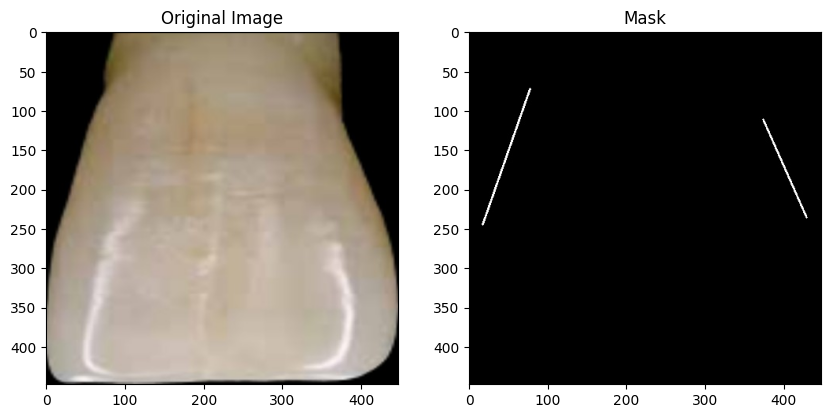

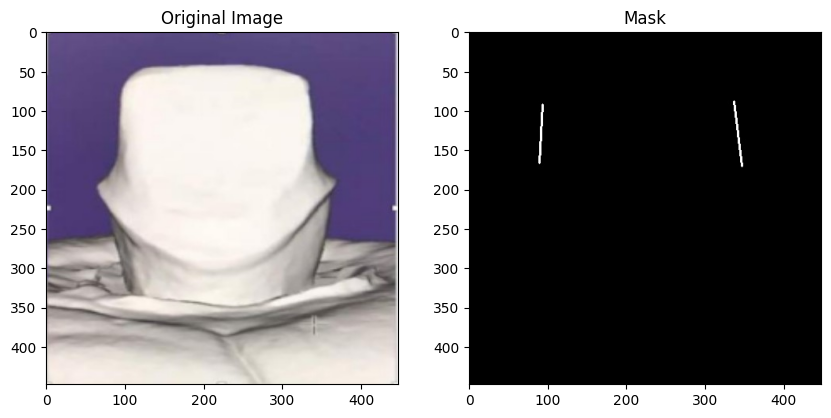

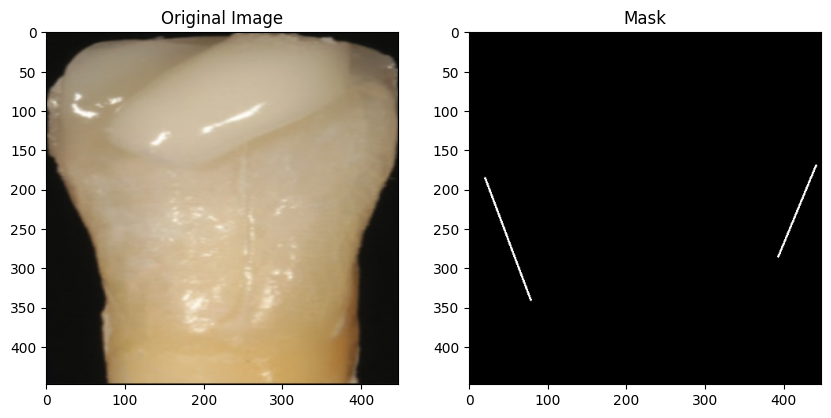

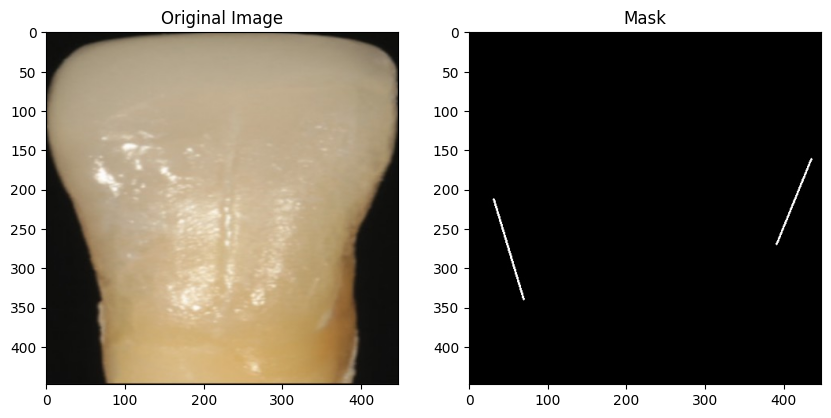

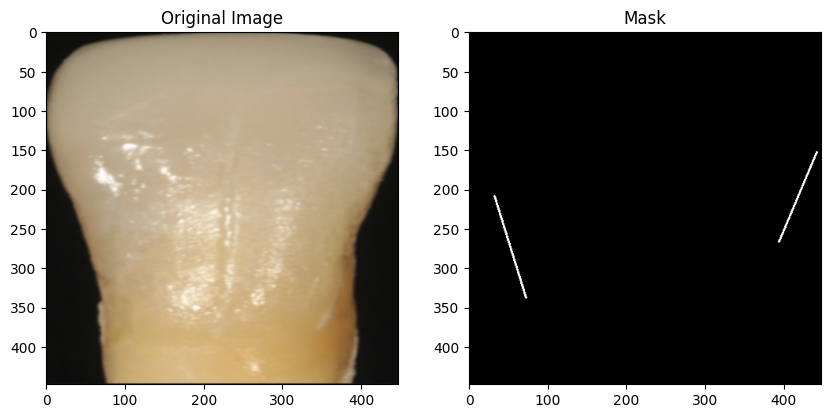

...

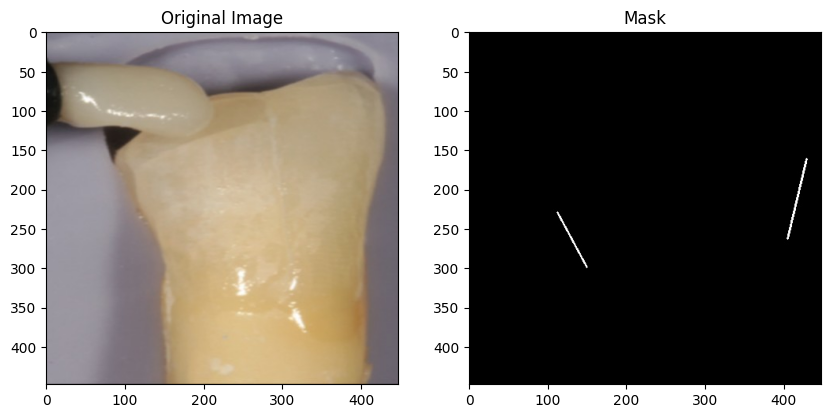

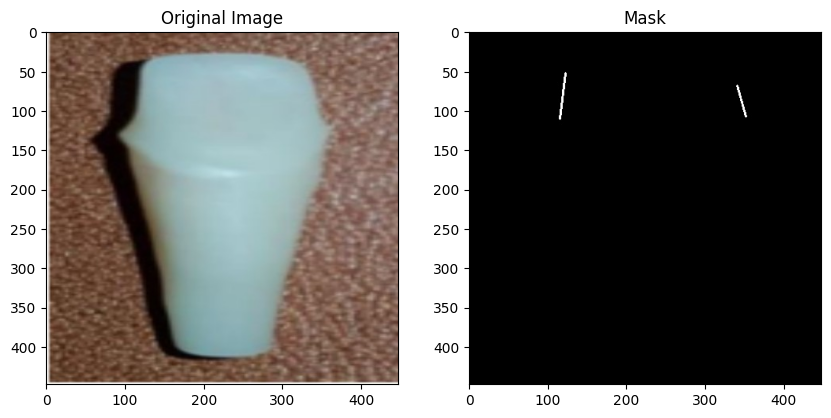

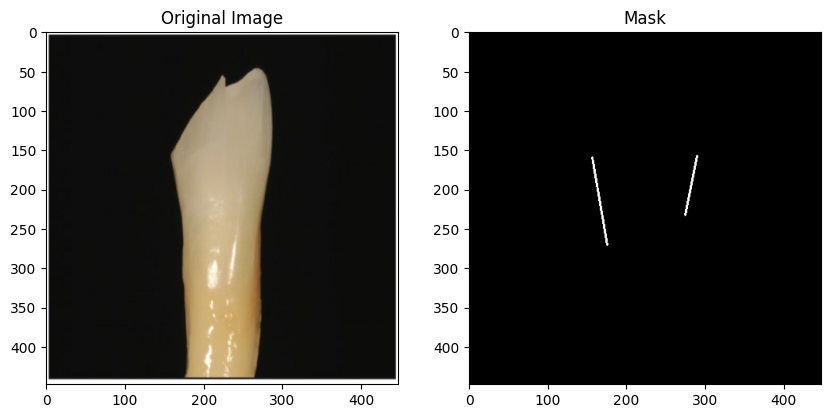

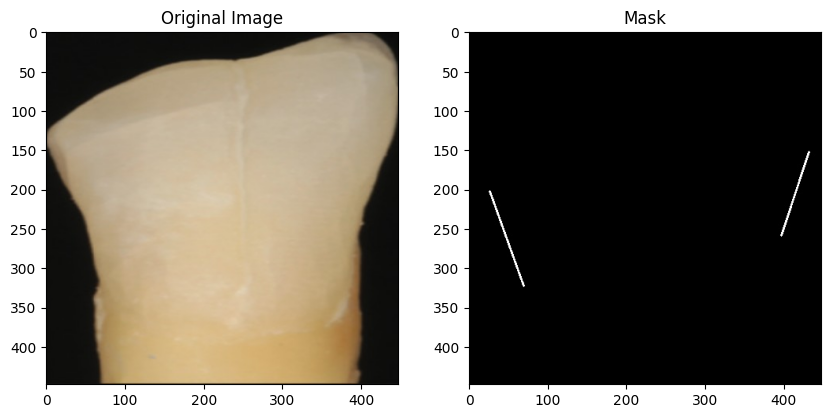

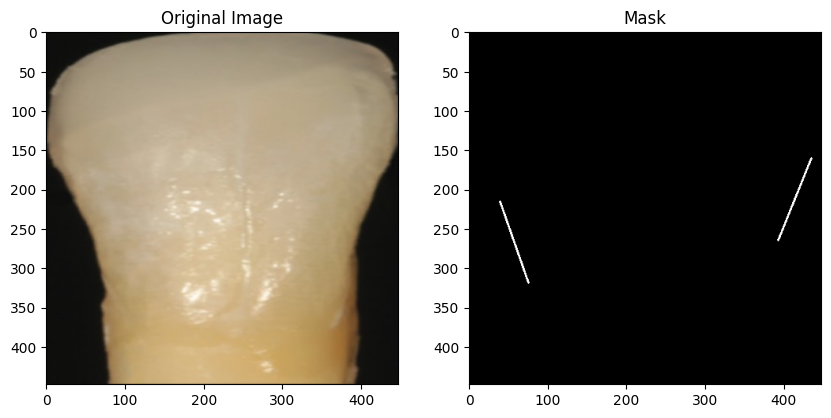

In [9]:
# Display images and masks side by side
for image, mask in zip(images, masks):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    # Display the original image
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')
    # Display the mask
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Mask')
    plt.show()


In [12]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Création d'un générateur de données d'image avec des augmentations désirées 
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='constant',
    cval=0
)

# Génération d'images et de masques augmentés
augmented_images = []
augmented_masks = []

for image, mask in zip(images, masks):
    image_batch = np.expand_dims(image, axis=0)
    mask_batch = np.expand_dims(mask, axis=0)

    # Application de l'augmentation de données aux images
    augmented_image_batch = data_generator.flow(image_batch, batch_size=1, shuffle=False)

    # Application de l'augmentation de données aux masques (utilisation de la même graine pour la cohérence)
    augmented_mask_batch = data_generator.flow(mask_batch, batch_size=1, shuffle=False)

    augmented_image = next(augmented_image_batch)[0]
    augmented_mask = next(augmented_mask_batch)[0]

    augmented_images.append(augmented_image) 
    augmented_masks.append(augmented_mask)

# Conversion des listes en tableaux NumPy
augmented_images = np.array(augmented_images) 
augmented_masks = np.array(augmented_masks)

# Vérification des formes des images et des masques augmentés
print(f'Augmented Images Size: {augmented_images.size}, Shape: {augmented_images.shape}') 
print(f'Augmented Masks Size: {augmented_masks.size}, Shape: {augmented_masks.shape}')



Augmented Images Size: 28901376, Shape: (48, 448, 448, 3)
Augmented Masks Size: 28901376, Shape: (48, 448, 448, 3)


In [13]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def build_unet(input_shape):
    inputs = Input(input_shape)
    
    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    # Decoder
    up2 = UpSampling2D(size=(2, 2))(pool1)
    up2 = Conv2D(64, 2, activation='relu', padding='same')(up2)
    merge2 = concatenate([conv1, up2], axis=3)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(merge2)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(conv2)

    outputs = Conv2D(1, 1, activation='sigmoid')(conv2)
    
    model = Model(inputs=inputs, outputs=outputs)
    return model


In [14]:
# Construction du modèle U-Net
input_shape = images[0].shape
model = build_unet(input_shape)
# Modification des masques pour avoir un seul canal 
augmented_masks_single_channel = augmented_masks[..., 0:1]


In [15]:
# Compilation du modèle
model.compile(optimizer='adam', loss='binary_crossentropy')
# Entraînement du modèle
model.fit(augmented_images, augmented_masks_single_channel, batch_size=8, epochs=10, validation_split=0.2)



Epoch 1/10

5/5 [==============================] - 154s 31s/step - loss: 14.0740 - val_loss: 0.7736
Epoch 2/10
5/5 [==============================] - 161s 31s/step - loss: 1.2204 - val_loss: 1.6763
Epoch 3/10
5/5 [==============================] - 156s 31s/step - loss: 1.3012 - val_loss: 2.0951
Epoch 4/10
5/5 [==============================] - 157s 31s/step - loss: 0.9769 - val_loss: 1.7547
Epoch 5/10
5/5 [==============================] - 161s 32s/step - loss: 0.9466 - val_loss: 1.3682
Epoch 6/10
5/5 [==============================] - 164s 33s/step - loss: 0.7222 - val_loss: 0.7589
Epoch 7/10
5/5 [==============================] - 161s 32s/step - loss: 0.6197 - val_loss: 0.8829
Epoch 8/10
5/5 [==============================] - 155s 31s/step - loss: 0.6576 - val_loss: 0.9834
Epoch 9/10
5/5 [==============================] - 168s 33s/step - loss: 0.6747 - val_loss: 1.0093
Epoch 10/10
5/5 [==============================] - 172s 34s/step - loss: 0.5840 - val_loss: 1.3592
